In [57]:
import tensorflow as tf
import matplotlib.pyplot as plt
import os
import json
import subprocess
from scipy.misc import imread
%matplotlib inline

import os
parentdir = os.path.dirname(os.path.dirname(os.path.abspath('__file__')))
os.sys.path.insert(0,parentdir)

from train import build_forward
from utils.rect import Rect
from utils.stitch_wrapper import stitch_rects
from evaluate import add_rectangles

In [58]:
hypes_file = '../hypes/overfeat_rezoom.json'
with open(hypes_file, 'r') as f:
    H = json.load(f)

INFO:tensorflow:Restoring parameters from ../data/overfeat_rezoom/save.ckpt-150000v2


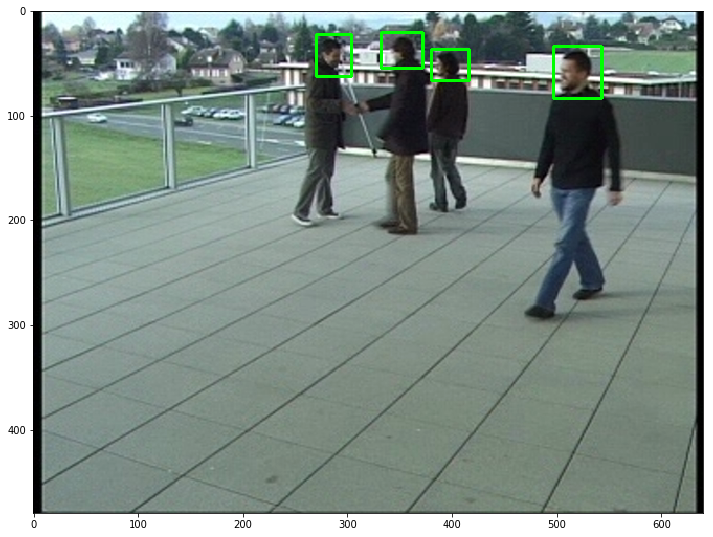

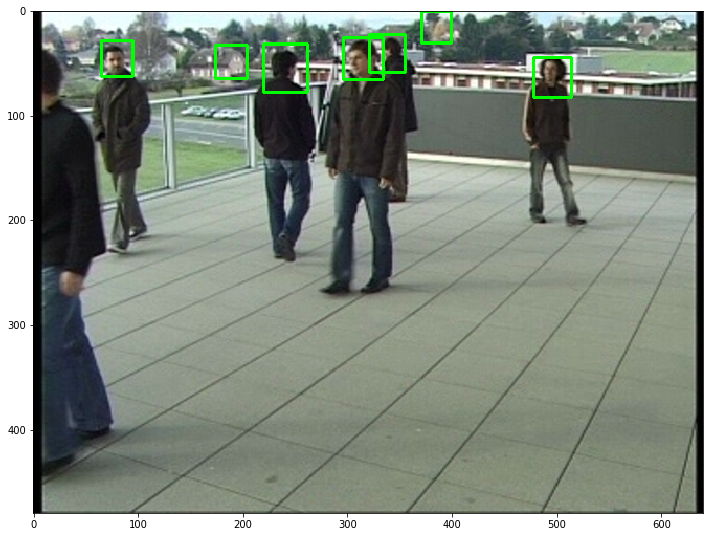

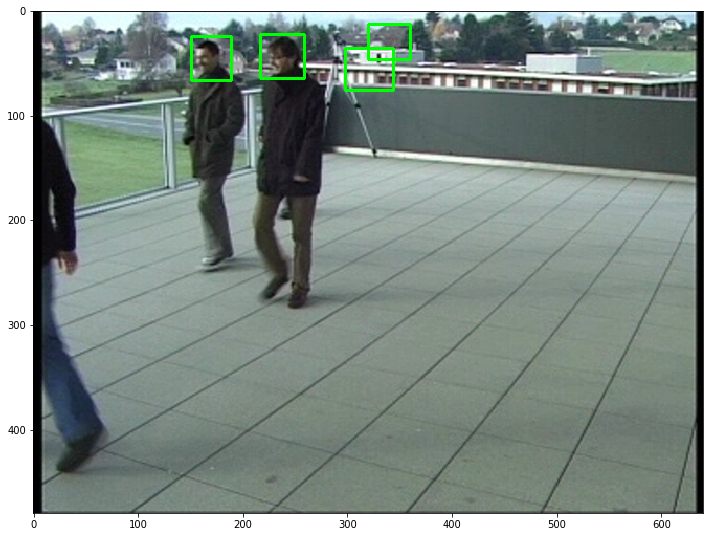

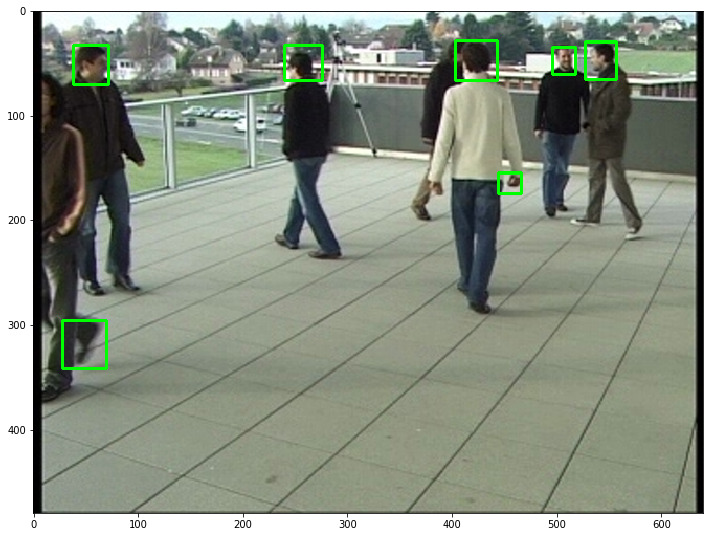

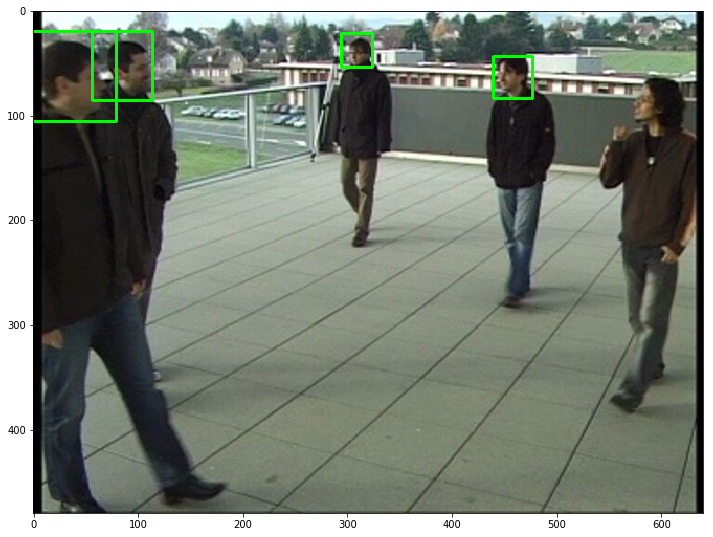

...

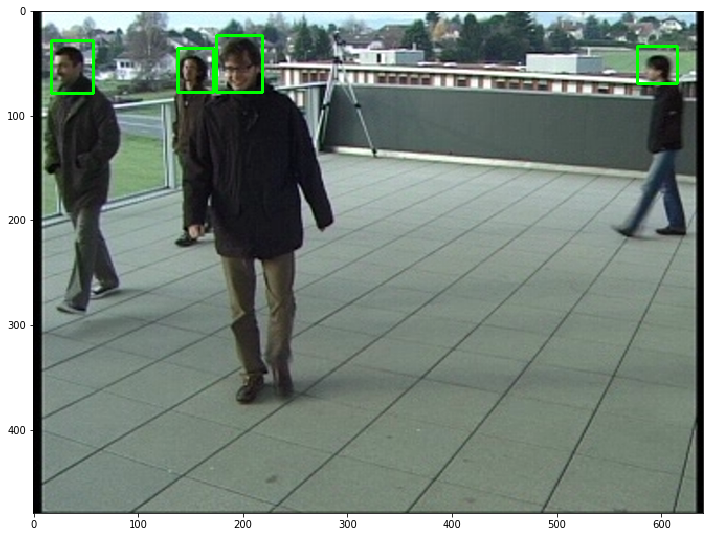

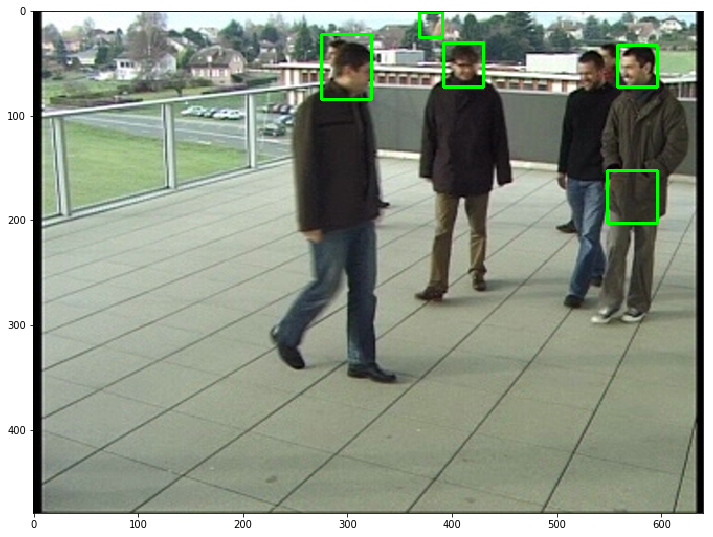

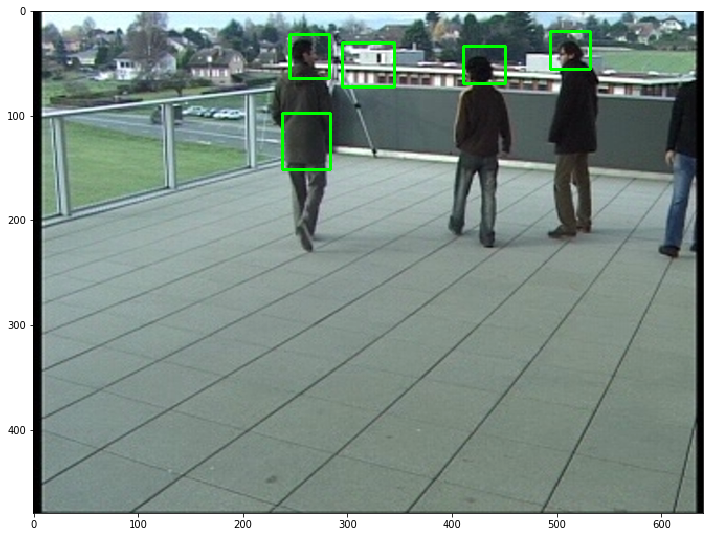

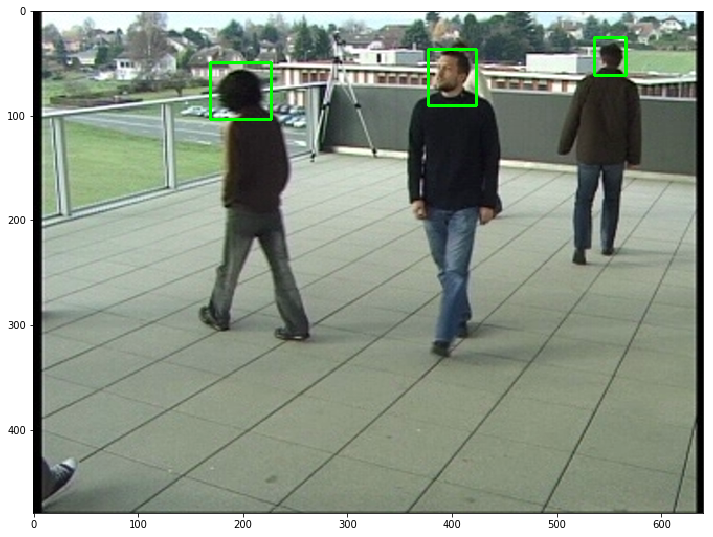

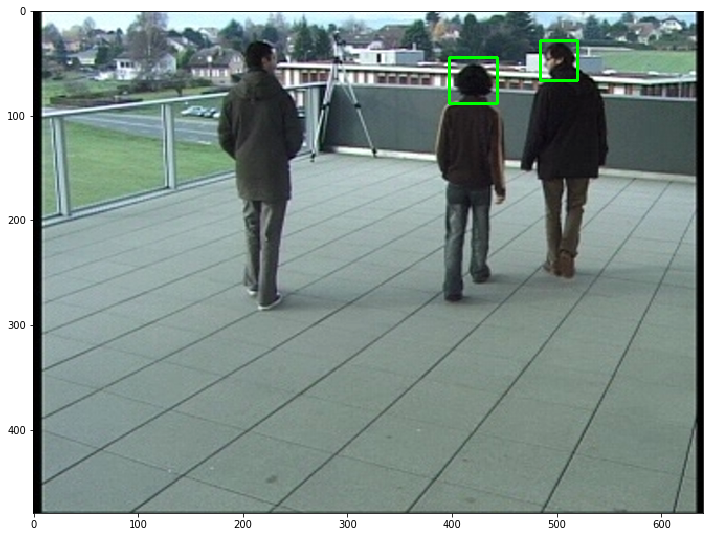

In [59]:
tf.reset_default_graph()
x_in = tf.placeholder(tf.float32, name='x_in', shape=[H['image_height'], H['image_width'], 3])
if H['use_rezoom']:
    pred_boxes, pred_logits, pred_confidences, pred_confs_deltas, pred_boxes_deltas = build_forward(H, tf.expand_dims(x_in, 0), 'test', reuse=None)
    grid_area = H['grid_height'] * H['grid_width']
    pred_confidences = tf.reshape(tf.nn.softmax(tf.reshape(pred_confs_deltas, [grid_area * H['rnn_len'], 2])), [grid_area, H['rnn_len'], 2])
    if H['reregress']:
        pred_boxes = pred_boxes + pred_boxes_deltas
else:
    pred_boxes, pred_logits, pred_confidences = build_forward(H, tf.expand_dims(x_in, 0), 'test', reuse=None)
saver = tf.train.Saver()

video_folder = '../data/my_video/'
save_folder = '../data/overfeat_rezoom/save.ckpt-150000v2'

from os import listdir
from os.path import isfile, join
video_files = [f for f in listdir(video_folder) if isfile(join(video_folder, f))]

with tf.Session() as sess:
    sess.run(tf.global_variables_initializer())
    saver.restore(sess, save_folder)
    for v in video_files:
        img = imread(os.path.join(video_folder, v))        
        feed = {x_in: img}
        (np_pred_boxes, np_pred_confidences) = sess.run([pred_boxes, pred_confidences], feed_dict=feed)
        new_img, rects = add_rectangles(H, [img], np_pred_confidences, np_pred_boxes,
                                        use_stitching=True, rnn_len=H['rnn_len'], min_conf=0.95, #0.7 - 0.95
                                        show_suppressed=False)

        fig = plt.figure(figsize=(12, 12))
        plt.imshow(new_img)